# Projeto de Regressão Logística


Neste projeto estaremos trabalhando com um conjunto de dados falso de publicidade, indicando se um usuário de internet específico clicou ou não em uma propaganda. Vamos tentar criar um modelo que preveja se clicará ou não em um anúncio baseado nos recursos desse usuário.

Este conjunto de dados contém os seguintes recursos:

* **tempo_diario_site**: tempo diário no site em minutos.
* **idade**: idade do consumidor.
* **renda_media_regiao**: Média da renda do consumidor na região.
* **tempo_medio_internet**: Média em minutos por dia que o consumidor está na internet.
* **titulo**: Título do anúncio.
* **cidade**: Cidade do consumidor.
* **sexo**: Se o consumidor era ou não masculino.
* **pais**: País do consumidor.
* **timestamp_clique'**: hora em que o consumidor clicou no anúncio ou janela fechada.
* **clique**: 0 ou 1 indicam se clicou ou não no anúncio.

## Etapas do projeto
- Coleta de dados
- Análise de dados
- Criação de modelos
- Validação de modelos
- Apresentação dos resultados

In [1]:
## Importar bibliotecas
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

## 1. Coleta de dados

In [2]:
anuncios = pd.read_csv(r"C:\Users\marcf\OneDrive\Documentos\Ciencia de dados\materiais-de-apoio-pandas - Curso Edu\materiais-apoio-regressao-logistica\materiais-apoio\advertising.csv")

** Verifique o cabeçalho do ad_data **

In [4]:
anuncios.head()

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,titulo,cidade,sexo,pais,timestamp_clique,clique
0,68.95,35,61833.90,256.09,Cloned 5thgeneration orchestration,Wrightburgh,0,Tunisia,2016-03-27 00:53:11,0
1,80.23,31,68441.85,193.77,Monitored national standardization,West Jodi,1,Nauru,2016-04-04 01:39:02,0
2,69.47,26,59785.94,236.50,Organic bottom-line service-desk,Davidton,0,San Marino,2016-03-13 20:35:42,0
3,74.15,29,54806.18,245.89,Triple-buffered reciprocal time-frame,West Terrifurt,1,Italy,2016-01-10 02:31:19,0
4,68.37,35,73889.99,225.58,Robust logistical utilization,South Manuel,0,Iceland,2016-06-03 03:36:18,0


In [5]:
anuncios.describe()

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,sexo,clique
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000
mean,65.000200,36.009000,55000.000080,180.000100,0.481000,0.50000
std,15.853615,8.785562,13414.634022,43.902339,0.499889,0.50025
min,32.600000,19.000000,13996.500000,104.780000,0.000000,0.00000
25%,51.360000,29.000000,47031.802500,138.830000,0.000000,0.00000
50%,68.215000,35.000000,57012.300000,183.130000,0.000000,0.50000
75%,78.547500,42.000000,65470.635000,218.792500,1.000000,1.00000
max,91.430000,61.000000,79484.800000,269.960000,1.000000,1.00000


In [6]:
anuncios.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   tempo_diario_site     1000 non-null   float64
 1   idade                 1000 non-null   int64  
 2   renda_media_regiao    1000 non-null   float64
 3   tempo_medio_internet  1000 non-null   float64
 4   titulo                1000 non-null   object 
 5   cidade                1000 non-null   object 
 6   sexo                  1000 non-null   int64  
 7   pais                  1000 non-null   object 
 8   timestamp_clique      1000 non-null   object 
 9   clique                1000 non-null   int64  
dtypes: float64(3), int64(3), object(4)
memory usage: 78.2+ KB


## 2. Análise de dados exploratória

- Vamos usar o Pandas profiling para gerar um relatórios dos dados
- Vamos usar o Seaborn para explorar os insights!


In [9]:
from pandas_profiling import ProfileReport

<ipython-input-9-e2a33329b6f0>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [13]:
relatorio = ProfileReport(anuncios, title='relatório dos Anúncios')
relatorio.to_file('relatorio_dos_anuncios_v1.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
relatorio

### Questionamentos 

- Existem dados ausentes? 
    - Não!
- Precisamos representar variáveis de outra forma? 
    - Sim a variável timestamp 
- Existem dados duplicados?
    - Não 
- Existem features compostas?
    - Sim a variável timestamp 
- Podemos integrar mais dados para análise?
    - Não! 
- Quais perguntas eu posso responder com estes dados?
- Como estão os dados? As feature alvo é balanceada?

### Informações
- São 10 variáveis (4 numericas e 6 categoricas: 3 float64, 3 int64 e 4 object)

### Insights
- idade padrão dos consumidores está entre 25 e 45 anos
- Consumidores mais velhos possuem renda média da região maiores do que os mais novos?
    - Não existe uma linearidade muito forte entre as variáveis
    - A renda não é tão dependente da idade
- Existe uma concentração de pontos na parte superior do gráfico mais a esquerda
- Com o KDE conseguimos exerga que as pessoas que gastam mais tempo no site
- A concentração de consumidores com idades entre 20 e 40 anos e tempo médio diário de 70 a 80 possuem uma maior concentração
- pessoas que ficam mais tempo no site constumam ficar mais tempo em outros sites da internet
- pessoas que ficam poouco tempo no site tendem a ficar menos tempo também em sites na internet
- Os daos se separam de alguma forma com as variáveis

** transformação de feature composta timestamp_clique **

In [15]:
anuncios['timestamp_clique']

0      2016-03-27 00:53:11
1      2016-04-04 01:39:02
2      2016-03-13 20:35:42
3      2016-01-10 02:31:19
4      2016-06-03 03:36:18
              ...         
995    2016-02-11 21:49:00
996    2016-04-22 02:07:01
997    2016-02-01 17:24:57
998    2016-03-24 02:35:54
999    2016-06-03 21:43:21
Name: timestamp_clique, Length: 1000, dtype: object

In [16]:
anuncios['timestamp_clique'].dtype

dtype('O')

In [17]:
anuncios['timestamp_clique'] = pd.to_datetime(anuncios['timestamp_clique'])

In [20]:
anuncios['timestamp_clique']

0     2016-03-27 00:53:11
1     2016-04-04 01:39:02
2     2016-03-13 20:35:42
3     2016-01-10 02:31:19
4     2016-06-03 03:36:18
              ...        
995   2016-02-11 21:49:00
996   2016-04-22 02:07:01
997   2016-02-01 17:24:57
998   2016-03-24 02:35:54
999   2016-06-03 21:43:21
Name: timestamp_clique, Length: 1000, dtype: datetime64[ns]

In [21]:
anuncios['ano'] = anuncios['timestamp_clique'].dt.year
anuncios['mes'] = anuncios['timestamp_clique'].dt.month
anuncios['dia'] = anuncios['timestamp_clique'].dt.day
anuncios['hora'] = anuncios['timestamp_clique'].dt.hour

In [22]:
anuncios

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,titulo,cidade,sexo,pais,timestamp_clique,clique,ano,mes,dia,hora
0,68.95,35,61833.90,256.09,Cloned 5thgeneration orchestration,Wrightburgh,0,Tunisia,2016-03-27 00:53:11,0,2016,3,27,0
1,80.23,31,68441.85,193.77,Monitored national standardization,West Jodi,1,Nauru,2016-04-04 01:39:02,0,2016,4,4,1
2,69.47,26,59785.94,236.50,Organic bottom-line service-desk,Davidton,0,San Marino,2016-03-13 20:35:42,0,2016,3,13,20
3,74.15,29,54806.18,245.89,Triple-buffered reciprocal time-frame,West Terrifurt,1,Italy,2016-01-10 02:31:19,0,2016,1,10,2
4,68.37,35,73889.99,225.58,Robust logistical utilization,South Manuel,0,Iceland,2016-06-03 03:36:18,0,2016,6,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,72.97,30,71384.57,208.58,Fundamental modular algorithm,Duffystad,1,Lebanon,2016-02-11 21:49:00,1,2016,2,11,21
996,51.30,45,67782.17,134.42,Grass-roots cohesive monitoring,New Darlene,1,Bosnia and Herzegovina,2016-04-22 02:07:01,1,2016,4,22,2
997,51.63,51,42415.72,120.37,Expanded intangible solution,South Jessica,1,Mongolia,2016-02-01 17:24:57,1,2016,2,1,17
998,55.55,19,41920.79,187.95,Proactive bandwidth-monitored policy,West Steven,0,Guatemala,2016-03-24 02:35:54,0,2016,3,24,2


###### ** Qual a idade padrão dos consumidores? 

Text(0.5, 0, 'idade')

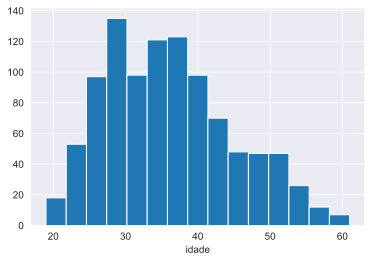

In [31]:
sns.set_style("darkgrid")
anuncios['idade'].hist(bins=15)
plt.xlabel('idade')

- Uma grande parte dos consumidores possuem idade entre 25 e 45 anos

In [24]:
anuncios.head()

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,titulo,cidade,sexo,pais,timestamp_clique,clique,ano,mes,dia,hora
0,68.95,35,61833.90,256.09,Cloned 5thgeneration orchestration,Wrightburgh,0,Tunisia,2016-03-27 00:53:11,0,2016,3,27,0
1,80.23,31,68441.85,193.77,Monitored national standardization,West Jodi,1,Nauru,2016-04-04 01:39:02,0,2016,4,4,1
2,69.47,26,59785.94,236.50,Organic bottom-line service-desk,Davidton,0,San Marino,2016-03-13 20:35:42,0,2016,3,13,20
3,74.15,29,54806.18,245.89,Triple-buffered reciprocal time-frame,West Terrifurt,1,Italy,2016-01-10 02:31:19,0,2016,1,10,2
4,68.37,35,73889.99,225.58,Robust logistical utilization,South Manuel,0,Iceland,2016-06-03 03:36:18,0,2016,6,3,3


###### Consumidores mais velhos possuem renda média da região maiores do que os mais novos?

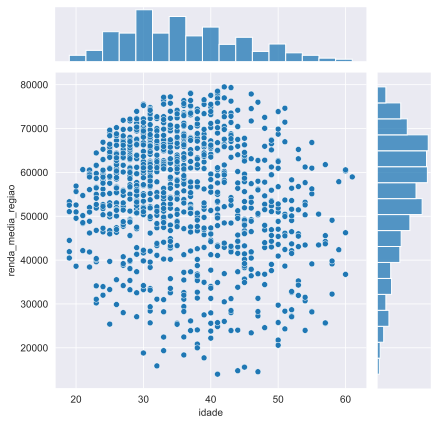

In [32]:
sns.jointplot(x='idade', y='renda_media_regiao',data=anuncios)

- Não existe uma linearidade muito forte entre as variáveis
- A renda não é tão dependente da idade

######  Pessoas mais novas gastam mais tempo no site do que pessoas mais velhas??

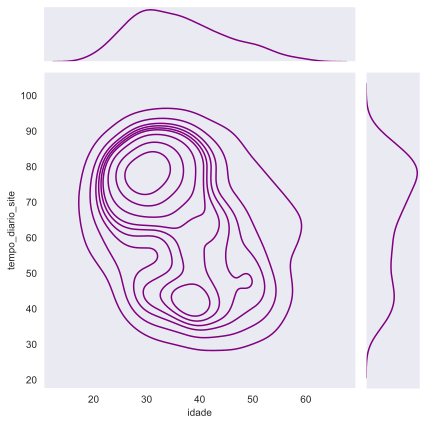

In [34]:
##Use KDE
sns.set_style('dark')
sns.jointplot(x='idade',y='tempo_diario_site',data=anuncios,kind='kde',color='purple');

- Existe uma concentração de pontos na parte superior do gráfico mais a esquerda
- Com o KDE conseguimos exerga que as pessoas que gastam mais tempo no site
- A concentração de consumidores com idades entre 20 e 40 anos e tempo médio diário de 70 a 80 possuem uma maior concentração 

In [35]:
anuncios

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,titulo,cidade,sexo,pais,timestamp_clique,clique,ano,mes,dia,hora
0,68.95,35,61833.90,256.09,Cloned 5thgeneration orchestration,Wrightburgh,0,Tunisia,2016-03-27 00:53:11,0,2016,3,27,0
1,80.23,31,68441.85,193.77,Monitored national standardization,West Jodi,1,Nauru,2016-04-04 01:39:02,0,2016,4,4,1
2,69.47,26,59785.94,236.50,Organic bottom-line service-desk,Davidton,0,San Marino,2016-03-13 20:35:42,0,2016,3,13,20
3,74.15,29,54806.18,245.89,Triple-buffered reciprocal time-frame,West Terrifurt,1,Italy,2016-01-10 02:31:19,0,2016,1,10,2
4,68.37,35,73889.99,225.58,Robust logistical utilization,South Manuel,0,Iceland,2016-06-03 03:36:18,0,2016,6,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,72.97,30,71384.57,208.58,Fundamental modular algorithm,Duffystad,1,Lebanon,2016-02-11 21:49:00,1,2016,2,11,21
996,51.30,45,67782.17,134.42,Grass-roots cohesive monitoring,New Darlene,1,Bosnia and Herzegovina,2016-04-22 02:07:01,1,2016,4,22,2
997,51.63,51,42415.72,120.37,Expanded intangible solution,South Jessica,1,Mongolia,2016-02-01 17:24:57,1,2016,2,1,17
998,55.55,19,41920.79,187.95,Proactive bandwidth-monitored policy,West Steven,0,Guatemala,2016-03-24 02:35:54,0,2016,3,24,2


###### Quem usa mais a internet gasta mais?

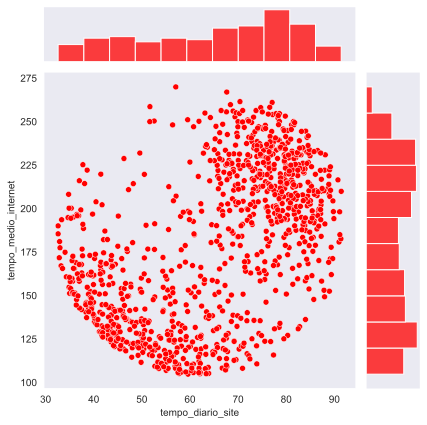

In [36]:
sns.jointplot(x='tempo_diario_site',y='tempo_medio_internet',data=anuncios, color='red');

- pessoas que ficam mais tempo no site constumam ficar mais tempo em outros sites da internet
- pessoas que ficam poouco tempo no site tendem a ficar menos tempo também em sites na internet

Quem são os consumidores que clicaram mais no site?

In [41]:
sns.pairplot(anuncios,hue='clique',height=2.5);

C:\Users\marcf\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\marcf\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


In [43]:
sns_plot = sns.pairplot(anuncios,hue='clique',height=2.5)
plt.savefig('output.png')

C:\Users\marcf\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\marcf\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


- Os daos se separam de alguma forma com as variáveis

# Regressão Logística

Agora é hora de quebrar nossos dados em treino e teste e fitar nosso modelo.

Você terá a liberdade aqui para escolher colunas em que deseja treinar!

**Divida os dados em conjunto de treinamento e conjunto de testes usando train_test_split**

In [45]:
from sklearn.model_selection import train_test_split

In [46]:
anuncios.columns

Index(['tempo_diario_site', 'idade', 'renda_media_regiao',
       'tempo_medio_internet', 'titulo', 'cidade', 'sexo', 'pais',
       'timestamp_clique', 'clique', 'ano', 'mes', 'dia', 'hora'],
      dtype='object')

In [47]:
X = anuncios[['tempo_diario_site', 'idade', 'tempo_medio_internet']] 
y = anuncios['clique']

In [49]:
X

,tempo_diario_site,idade,tempo_medio_internet
0,68.95,35,256.09
1,80.23,31,193.77
2,69.47,26,236.50
3,74.15,29,245.89
4,68.37,35,225.58
...,...,...,...
995,72.97,30,208.58
996,51.30,45,134.42
997,51.63,51,120.37
998,55.55,19,187.95


In [50]:
y

0      0
1      0
2      0
3      0
4      0
      ..
995    1
996    1
997    1
998    0
999    1
Name: clique, Length: 1000, dtype: int64

In [51]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [52]:
X_train

,tempo_diario_site,idade,tempo_medio_internet
703,77.65,28,208.01
311,69.74,49,243.37
722,39.47,43,163.48
629,73.94,26,236.15
0,68.95,35,256.09
...,...,...,...
106,72.23,25,241.03
270,44.49,53,168.00
860,91.37,45,182.65
435,56.66,42,139.42


In [53]:
X_test

,tempo_diario_site,idade,tempo_medio_internet
521,63.26,29,120.46
737,71.23,52,122.59
740,43.63,38,135.25
660,42.04,49,182.11
411,78.68,29,208.05
...,...,...,...
506,77.05,31,236.64
342,88.12,38,230.91
485,66.88,35,119.47
711,69.96,31,214.06


In [54]:
y_train

703    0
311    0
722    1
629    0
0      0
      ..
106    0
270    1
860    1
435    1
102    0
Name: clique, Length: 670, dtype: int64

In [55]:
y_test

521    1
737    1
740    1
660    1
411    0
      ..
506    0
342    0
485    1
711    0
133    0
Name: clique, Length: 330, dtype: int64

**Treinando e ajustando o modelo de regressão logística no conjunto de treinamento**

In [57]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

In [59]:
logmodel = LogisticRegression()
logmodel.fit(X_train,y_train)

LogisticRegression()

## Previsões e avaliações
**prevendo valores para os dados de teste.**

In [61]:
p_test = logmodel.predict(X_test)

**Criando um relatório de classificação para o modelo.**

In [62]:
accuracy_score(y_test, p_test)

0.9454545454545454

In [63]:
print(classification_report(y_test, p_test))

              precision    recall  f1-score   support

           0       0.93      0.96      0.95       162
           1       0.96      0.93      0.95       168

    accuracy                           0.95       330
   macro avg       0.95      0.95      0.95       330
weighted avg       0.95      0.95      0.95       330



## Acurácia de acordo com a entrada
- tempo_diario_site, idade, renda_media_regiao, tempo_medio_internet, sexo  -> **90.60%**
- tempo_diario_site, idade, renda_media_regiao, tempo_medio_internet, sexo, mês -> **90,00%**
- tempo_diario_site, idade, renda_media_regiao, tempo_medio_internet, sexo, mês, dia -> **90,30%**
- idade, renda_media_regiao, tempo_medio_internet, sexo, mes, day -> **86,96%**
- tempo_diario_site, renda_media_regiao, tempo_medio_internet, sexo, mês, dia -> **66,06%**
- tempo_diario_site, idade, tempo_medio_internet, sexo  -> **94.54%**
- tempo_diario_site, idade, renda_media_regiao, sexo  -> **90.60%**
- tempo_diario_site, idade, renda_media_regiao,tempo_medio_internet -> **90.60%**
- tempo_diario_site, idade, tempo_medio_internet -> **94,54%**

### Conclusões
- O modelo atingiu bons resultados considerando 90.60% de acurácia usando 5 variáveis
- O mês e dia não ajudou a separar o modelo, talvez a quantidade de dados seja insuficiente para considerar o tempo
- O tempo diario no site, a idade e o tempo médio de internet são os atributos mais importantes para o clique
- Poderiamos melhorar o resultado integrando mais dados ou fazendo engenharia de features

Fazendo um for para verificar o aumento de variáveis